In [1]:
import numpy 
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import metrics
import matplotlib.patches as mpatches
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
import scipy.stats as st 
import dtale 
import warnings
import random
from sklearn.model_selection import StratifiedKFold 
import plotly.express as px
from imblearn.over_sampling import RandomOverSampler
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
warnings.filterwarnings('ignore')
import pandas_profiling as pdp
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import roc_curve
from statsmodels.stats import weightstats as stests
import pandas_profiling as pp
from sklearn.preprocessing import StandardScaler

In [2]:
#import data 
connect_mobile=pd.read_excel('Connect_Mobile__Attrition_Data_file.xlsx')
connect_mobile.head()


,active_cust,income,expenditure,months_on_network,Num_complaints,number_plan_changes,relocated,monthly_bill,technical_issues_per_month,Speed_test_result
0,0,1586,1268.8,85,4,1,0,121,4,85
1,0,1581,1264.8,85,4,1,0,133,4,85
2,0,1594,1275.2,82,4,1,0,118,4,85
3,0,1594,1275.2,82,4,1,0,123,4,85
4,1,1609,1287.2,80,4,1,0,177,4,85


In [3]:
connect_mobile_ori=connect_mobile.copy(deep=True)

In [4]:
#missing data information
connect_mobile.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 10 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   active_cust                 100000 non-null  int64  
 1   income                      100000 non-null  int64  
 2   expenditure                 100000 non-null  float64
 3   months_on_network           100000 non-null  int64  
 4   Num_complaints              100000 non-null  int64  
 5   number_plan_changes         100000 non-null  int64  
 6   relocated                   100000 non-null  int64  
 7   monthly_bill                100000 non-null  int64  
 8   technical_issues_per_month  100000 non-null  int64  
 9   Speed_test_result           100000 non-null  int64  
dtypes: float64(1), int64(9)
memory usage: 7.6 MB


# visualization

In [5]:
# profile = pp.ProfileReport(connect_mobile) 
# profile.to_file("output.html")

In [6]:
'''Result:here no any missing values '''

'Result:here no any missing values '

In [7]:
# remove outliers
connect_mobile_remove_outlier=connect_mobile[(np.abs(st.zscore(connect_mobile)) < 3).all(axis=1)]

In [8]:
#i think we don't need to clean data because all data already clean by excel sheet

In [9]:
#unique value for each colums 
connect_mobile_remove_outlier.nunique()

active_cust                      2
income                        1156
expenditure                   1823
months_on_network              111
Num_complaints                   1
number_plan_changes              7
relocated                        2
monthly_bill                    95
technical_issues_per_month       5
Speed_test_result               22
dtype: int64

In [10]:
# here we can see Num_complaints same for all dataset so it's doesn't contain any information 
connect_mobile_remove_outlier=connect_mobile_remove_outlier.drop('Num_complaints',axis=1)

In [11]:
#statistics summary 
connect_mobile_remove_outlier.describe() # optional 

,active_cust,income,expenditure,months_on_network,number_plan_changes,relocated,monthly_bill,technical_issues_per_month,Speed_test_result
count,88518.000000,88518.000000,88518.000000,88518.000000,88518.000000,88518.000000,88518.000000,88518.000000,88518.000000
mean,0.595980,1819.124517,1376.362972,57.489415,1.156149,0.088784,96.019612,3.307316,81.300538
std,0.490704,176.402269,188.277482,15.625873,1.153149,0.284434,50.302753,1.251839,3.888806
min,0.000000,1457.000000,969.800000,3.000000,0.000000,0.000000,30.000000,1.000000,72.000000
25%,0.000000,1681.000000,1245.600000,47.000000,0.000000,0.000000,45.000000,3.000000,78.000000
50%,1.000000,1810.000000,1361.600000,55.000000,1.000000,0.000000,87.000000,4.000000,81.000000
75%,1.000000,1909.000000,1494.400000,69.000000,2.000000,0.000000,134.000000,4.000000,85.000000
max,1.000000,3684.000000,2947.200000,113.000000,6.000000,1.000000,181.000000,7.000000,93.000000


In [12]:
# what happend if we build left_money incom-expenditure 
connect_mobile_remove_outlier['left_money']=connect_mobile_remove_outlier['income']-connect_mobile_remove_outlier['expenditure']

In [13]:

connect_mobile_remove_outlier['std_income']= ((connect_mobile_remove_outlier['income']-connect_mobile_remove_outlier['income'].mean())/connect_mobile_remove_outlier['income'].std())
connect_mobile_remove_outlier['std_expenditure']= ((connect_mobile_remove_outlier['expenditure']-connect_mobile_remove_outlier['expenditure'].mean())/connect_mobile_remove_outlier['income'].std())

connect_mobile_remove_outlier['std_left_money']=connect_mobile_remove_outlier['std_income']-connect_mobile_remove_outlier['std_expenditure']

In [14]:
# class is imbalanced 
connect_mobile_remove_outlier['active_cust'].value_counts()

1    52755
0    35763
Name: active_cust, dtype: int64

<AxesSubplot:xlabel='active_cust', ylabel='count'>

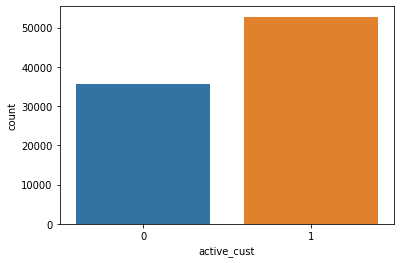

In [15]:
# check class balanced or not 
sns.countplot(data=connect_mobile_remove_outlier,x='active_cust')

# Feature Selection

## Relationship between continues feature  and catgrorical feature

In [16]:
# what is relationship between active_cust and income 
px.histogram(data_frame=connect_mobile_remove_outlier,x='std_income',
             color='active_cust',
             color_discrete_map={0:'red',1:'green'},opacity=0.7,range_x=[-3,3])

In [17]:
'''conclusion:i think both class follow normal distribution but we needs full proof so we will perform hypothesis
but we can't forget here standard deviation '''


"conclusion:i think both class follow normal distribution but we needs full proof so we will perform hypothesis\nbut we can't forget here standard deviation "

In [18]:
data1=connect_mobile_remove_outlier[connect_mobile_remove_outlier['active_cust']==0]['std_income']
data2=connect_mobile_remove_outlier[connect_mobile_remove_outlier['active_cust']==1]['std_income']

In [19]:
# both class 
# h0: both class mean1=mean2
# h1 : both class mean1!=mean2 
data1=connect_mobile_remove_outlier[connect_mobile_remove_outlier['active_cust']==0]['std_income']
data2=connect_mobile_remove_outlier[connect_mobile_remove_outlier['active_cust']==1]['std_income']
print("class 0 mean,median,std ",np.mean(data1), np.median(data1),np.std(data1))
print("class 1,mean,median,std ",np.mean(data2), np.median(data2),np.std(data2))
stat, p = stests.ztest(data1, data2)
print('Statistics=%.3f, p=%.3f' % (stat, p))
# interpret
alpha = 0.05
if p > alpha:
    print('Same mean (fail to reject H0)')
else:
    print('Different mean (reject H0) ')


class 0 mean,median,std  0.2189615161386376 0.17502883149536613 0.913987007100034
class 1,mean,median,std  -0.14843561182193113 -0.3465064112823444 1.028128679824679
Statistics=54.531, p=0.000
Different mean (reject H0) 


<b> Note here Type 1 error occur </b>

In [20]:
'''Conclusion : income is not playing significant role in the active_cust'''

'Conclusion : income is not playing significant role in the active_cust'

In [21]:
# what is relationship between active_cust and left_money 
px.histogram(data_frame=connect_mobile_remove_outlier,x='std_left_money',
             color='active_cust',
             color_discrete_map={0:'red',1:'green'},opacity=0.7,range_x=[-3,3])

<p> The values for asymmetry and kurtosis between -2 and +2 are considered acceptable in order to prove normal univariate distribution (George & Mallery, 2010). Hair et al. (2010) and Bryne (2010) 
argued that data is considered to be normal if skewness is between ‐2 to +2 and kurtosis is between ‐7 to +7<p>

In [22]:
# both class 
# h0: both class mean1=mean2
# h1 : both class mean1!=mean2  
data1=connect_mobile_remove_outlier[connect_mobile_remove_outlier['active_cust']==0]['left_money']
data2=connect_mobile_remove_outlier[connect_mobile_remove_outlier['active_cust']==1]['left_money']
print("class 0 mean,median,std ",np.mean(data1), np.median(data1),np.std(data1))
print("class 1,mean,median,std ",np.mean(data2), np.median(data2),np.std(data2))
print('skweness 0=',data1.skew())
print('skweness 1=',data2.skew())
print("Kurtosis 0=",data1.kurtosis())
print("Kurtosis 1=",data2.kurtosis())
stat, p = stests.ztest(data1, data2)

print('Statistics=%.3f, p=%.3f' % (stat, p))
# interpret
alpha = 0.05
if p > alpha:
    print('Same mean (fail to reject H0)')
else:
    print('Different mean (reject H0) ')


class 0 mean,median,std  434.5917568436648 377.20000000000005 117.31045962448114
class 1,mean,median,std  448.2999042744731 381.4000000000001 135.0054122790984
skweness 0= 1.1368750883736893
skweness 1= 0.7355607390954585
Kurtosis 0= -0.3273160218191058
Kurtosis 1= -1.0194272391813364
Statistics=-15.617, p=0.000
Different mean (reject H0) 


<b> Note: here Type 1 error occur </b>

In [23]:
'''Conclusion : left_money is not playing significant role in the active_cust'''

'Conclusion : left_money is not playing significant role in the active_cust'

In [24]:
connect_mobile_remove_outlier=connect_mobile_remove_outlier.drop(['income','left_money','expenditure'
                                                                 ,'std_income','std_left_money','std_expenditure'],axis=1)

## Relationship between categoricals features 

In [25]:
connect_mobile_remove_outlier.columns

Index(['active_cust', 'months_on_network', 'number_plan_changes', 'relocated',
       'monthly_bill', 'technical_issues_per_month', 'Speed_test_result'],
      dtype='object')

In [26]:
'''Here feature is ['active_cust', 'months_on_network', 'number_plan_changes', 'relocated', 'monthly_bill',
       'technical_issues_per_month', 'Speed_test_result'] '''

"Here feature is ['active_cust', 'months_on_network', 'number_plan_changes', 'relocated', 'monthly_bill',\n       'technical_issues_per_month', 'Speed_test_result'] "

In [27]:
#visulization 

fig=px.sunburst(data_frame=connect_mobile_remove_outlier,
            path=['active_cust', 'months_on_network'],
           color='active_cust')
fig.show()

In [28]:
fig=px.sunburst(data_frame=connect_mobile_remove_outlier,
            path=['active_cust', 'number_plan_changes'],
           color='active_cust')
fig.show()

In [29]:
fig=px.sunburst(data_frame=connect_mobile_remove_outlier,
            path=['active_cust', 'relocated'],
           color='active_cust')
fig.show()

In [30]:
fig=px.sunburst(data_frame=connect_mobile_remove_outlier,
            path=['active_cust', 'monthly_bill'],
           color='active_cust')
fig.show()

In [31]:
fig=px.sunburst(data_frame=connect_mobile_remove_outlier,
            path=['active_cust', 'technical_issues_per_month'],
           color='active_cust')
fig.show()

In [32]:
fig=px.sunburst(data_frame=connect_mobile_remove_outlier,
            path=['active_cust', 'Speed_test_result'],
           color='active_cust')
fig.show()

In [33]:
connect_mobile_remove_outlier.columns

Index(['active_cust', 'months_on_network', 'number_plan_changes', 'relocated',
       'monthly_bill', 'technical_issues_per_month', 'Speed_test_result'],
      dtype='object')

In [34]:
l1=[]
for i in connect_mobile_remove_outlier.columns:
    if i not in  ['active_cust','income','expenditure']:
        
        df=pd.crosstab(connect_mobile_remove_outlier['active_cust'],connect_mobile_remove_outlier[i])
        stat, p, dof, expected = st.chi2_contingency(df,correction=True)
     
        deno=sum(df.sum())
        x=numpy.sqrt(stat / deno)
        if(x>0.25): #thresold
             l1.append((i,x))

In [35]:
l1

[('months_on_network', 0.3579122411836969),
 ('number_plan_changes', 0.3396596159283308),
 ('relocated', 0.3249254408284224),
 ('technical_issues_per_month', 0.2772876932584277),
 ('Speed_test_result', 0.4577236516628575)]

In [36]:
# so here we can see monthly_bill is not significant relationship 
# so monthly bill is not significant



In [37]:
connect_mobile_remove_outlier.columns


Index(['active_cust', 'months_on_network', 'number_plan_changes', 'relocated',
       'monthly_bill', 'technical_issues_per_month', 'Speed_test_result'],
      dtype='object')

In [38]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(connect_mobile_remove_outlier.iloc[:,:-1])

In [39]:
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['pc1', 'pc2','pc3'])

In [40]:
finalDf = pd.concat([principalDf, connect_mobile_remove_outlier['active_cust']] ,axis = 1) 

In [41]:
px.scatter_3d(data_frame=finalDf,x='pc1',y='pc2',z='pc3',
              color='active_cust')

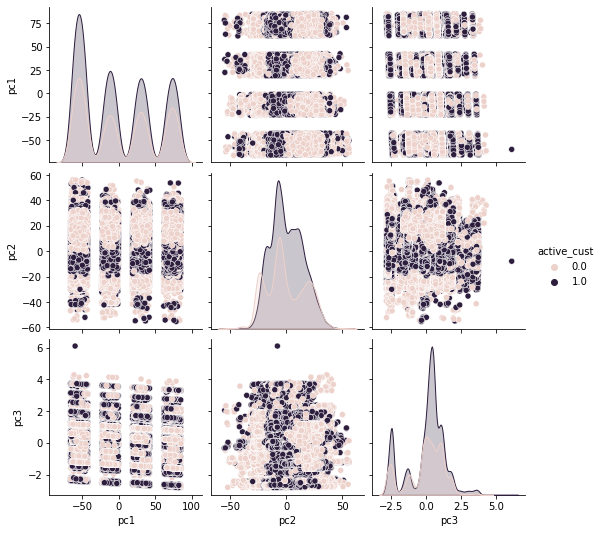

In [42]:
sns.pairplot(finalDf,hue='active_cust')

In [43]:
final_feature=connect_mobile_remove_outlier.columns
final_feature

Index(['active_cust', 'months_on_network', 'number_plan_changes', 'relocated',
       'monthly_bill', 'technical_issues_per_month', 'Speed_test_result'],
      dtype='object')

In [44]:
## Final Feature is ['active_cust', 'months_on_network', 'number_plan_changes', 'relocated',
#        'technical_issues_per_month', 'Speed_test_result']

# imbalanced data try to balanced 

In [45]:
X=connect_mobile_remove_outlier[final_feature[1:]]
y=connect_mobile_remove_outlier[final_feature[0]]


In [46]:
#class is imbalanced 
from imblearn.under_sampling import RandomUnderSampler


rus = RandomOverSampler(sampling_strategy=1,random_state=34)
X,y=rus.fit_resample(X,y)



y.value_counts()

0    52755
1    52755
Name: active_cust, dtype: int64

# Random forest

In [47]:
from sklearn.ensemble import RandomForestClassifier
clf=RandomForestClassifier(max_depth=6,min_samples_split=4)

In [48]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.33)
clf=RandomForestClassifier(max_depth=6,min_samples_split=2)
clf.fit(X_train,y_train)

RandomForestClassifier(max_depth=6)

In [49]:
clf.score(X_test,y_test)

0.8244062149975588

In [50]:
y_pred=clf.predict(X_test)
y_pred

array([1, 1, 0, ..., 0, 0, 0], dtype=int64)

In [51]:
print(confusion_matrix(y_test,y_pred))

[[13735  3578]
 [ 2536 14970]]


In [52]:
print((classification_report(y_test,y_pred)))

              precision    recall  f1-score   support

           0       0.84      0.79      0.82     17313
           1       0.81      0.86      0.83     17506

    accuracy                           0.82     34819
   macro avg       0.83      0.82      0.82     34819
weighted avg       0.83      0.82      0.82     34819



In [53]:
lst_accu_stratified = [] 
x=0
feature_common=pd.DataFrame()
skf = StratifiedKFold(n_splits=12, shuffle=True, random_state=1) 
for train_index, test_index in skf.split(X, y): 
    x_train_fold, x_test_fold = X.loc[train_index,:], X.loc[test_index,:] 
    y_train_fold, y_test_fold = y[train_index], y[test_index] 
    clf.fit(x_train_fold, y_train_fold)
#     feature_common[x]=feature_extract(clf,X_train.columns)
#     x+=1
    lst_accu_stratified.append(clf.score(x_test_fold, y_test_fold))
   
    
    
print('List of possible accuracy:', lst_accu_stratified) 
print('\nMaximum Accuracy That can be obtained from this model is:', 
      max(lst_accu_stratified)*100, '%') 
print('\nMinimum Accuracy:', 
      min(lst_accu_stratified)*100, '%') 
print('\nAverage Accuracy That can be obtained from this model is::',np.mean(lst_accu_stratified)) 
print('\n Median Accuracy That can be obtained from this model is::',np.median(lst_accu_stratified)) 
print('\nStandard Deviation is:',np.std(lst_accu_stratified))

List of possible accuracy: [0.8291823041055385, 0.8224724212441715, 0.8383941771863983, 0.8220175139315364, 0.8300921187308086, 0.8274764016831571, 0.8343949044585988, 0.8265468607825296, 0.8338262056414922, 0.8325750682438581, 0.8354185623293904, 0.831778889899909]

Maximum Accuracy That can be obtained from this model is: 83.83941771863984 %

Minimum Accuracy: 82.20175139315364 %

Average Accuracy That can be obtained from this model is:: 0.8303479523531158

 Median Accuracy That can be obtained from this model is:: 0.8309355043153588

Standard Deviation is: 0.0048431652523272485


## Hyper parameter tuning

In [54]:
from sklearn.model_selection import RandomizedSearchCV,GridSearchCV
n_estimators = [int(x) for x in np.linspace(start = 5 , stop = 15, num = 10)]
max_features = ['auto', 'log2']

max_depth = [int(x) for x in np.linspace(5, 10, num = 2)] 

max_depth.append(None)

bootstrap = [True, False]

r_grid = {'n_estimators': n_estimators,

               'max_features': max_features,

               'max_depth': max_depth,

               'bootstrap': bootstrap}

print(r_grid)

{'n_estimators': [5, 6, 7, 8, 9, 10, 11, 12, 13, 15], 'max_features': ['auto', 'log2'], 'max_depth': [5, 10, None], 'bootstrap': [True, False]}


In [55]:
clf=RandomForestClassifier()

In [56]:
grid_clf_f = GridSearchCV(estimator=clf, param_grid=r_grid,
                                scoring='f1', cv = 5, verbose=2, 
                                n_jobs=-1, return_train_score=True)

In [57]:
grid_clf_f.fit(X_train, y_train)
print(grid_clf_f.best_params_)


Fitting 5 folds for each of 120 candidates, totalling 600 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:   12.9s
[Parallel(n_jobs=-1)]: Done 154 tasks      | elapsed:   47.7s
[Parallel(n_jobs=-1)]: Done 357 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done 600 out of 600 | elapsed:  3.7min finished


{'bootstrap': True, 'max_depth': None, 'max_features': 'log2', 'n_estimators': 15}


## Recreate Model 

In [67]:
params={'bootstrap': 'True', 'max_depth': None, 'max_features': 'log2', 'n_estimators': 15}

re_rfr=RandomForestClassifier(**params)

re_rfr.fit(X_train,y_train)

re_rfr.score(X_test,y_test)

0.8757862086791695

In [68]:
y_pred=re_rfr.predict(X_test)
y_pred

array([1, 1, 0, ..., 0, 0, 0], dtype=int64)

In [69]:
print(confusion_matrix(y_test,y_pred))

[[15316  1997]
 [ 2328 15178]]


In [70]:
print((classification_report(y_test,y_pred)))

              precision    recall  f1-score   support

           0       0.87      0.88      0.88     17313
           1       0.88      0.87      0.88     17506

    accuracy                           0.88     34819
   macro avg       0.88      0.88      0.88     34819
weighted avg       0.88      0.88      0.88     34819



In [71]:
lst_accu_stratified = [] 
x=0
feature_common=pd.DataFrame()
skf = StratifiedKFold(n_splits=12, shuffle=True, random_state=1) 
for train_index, test_index in skf.split(X, y): 
    x_train_fold, x_test_fold = X.loc[train_index,:], X.loc[test_index,:] 
    y_train_fold, y_test_fold = y[train_index], y[test_index] 
    re_rfr.fit(x_train_fold, y_train_fold)
#     feature_common[x]=feature_extract(clf,X_train.columns)
#     x+=1
    lst_accu_stratified.append(re_rfr.score(x_test_fold, y_test_fold))
   
    
    
print('List of possible accuracy:', lst_accu_stratified) 
print('\nMaximum Accuracy That can be obtained from this model is:', 
      max(lst_accu_stratified)*100, '%') 
print('\nMinimum Accuracy:', 
      min(lst_accu_stratified)*100, '%') 
print('\nAverage Accuracy That can be obtained from this model is::',np.mean(lst_accu_stratified)) 
print('\nMedian Accuracy That can be obtained from this model is::',np.median(lst_accu_stratified)) 
print('\nStandard Deviation is:',np.std(lst_accu_stratified))

List of possible accuracy: [0.8861594450130786, 0.8851359035596498, 0.8943477766405095, 0.8857045377004436, 0.8852496303878085, 0.8870692596383487, 0.8879663330300273, 0.8902411282984531, 0.8854640582347588, 0.8876251137397634, 0.87852593266606, 0.8856915377616015]

Maximum Accuracy That can be obtained from this model is: 89.43477766405094 %

Minimum Accuracy: 87.85259326660601 %

Average Accuracy That can be obtained from this model is:: 0.8865983880558752

Median Accuracy That can be obtained from this model is:: 0.8859319913567612

Standard Deviation is: 0.003520097113497587


# GradientBoosting

In [63]:
from sklearn.ensemble import GradientBoostingClassifier

In [64]:
clf=GradientBoostingClassifier()

In [65]:
clf.get_params()

{'ccp_alpha': 0.0,
 'criterion': 'friedman_mse',
 'init': None,
 'learning_rate': 0.1,
 'loss': 'deviance',
 'max_depth': 3,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 100,
 'n_iter_no_change': None,
 'presort': 'deprecated',
 'random_state': None,
 'subsample': 1.0,
 'tol': 0.0001,
 'validation_fraction': 0.1,
 'verbose': 0,
 'warm_start': False}

In [66]:
gdb_clf = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0, 
                                 max_depth=1, random_state=0).fit(X_train, y_train).fit(X_train, y_train)
gdb_clf.score(X_test,y_test)

0.8150147907751515

## How to read fast data by df_chunk

In [97]:
chunksize=10**4

In [98]:
df=pd.DataFrame()
for chunk in pd.read_csv('Connect_Mobile__Attrition_Data_file.csv', chunksize=chunksize):
    df=pd.concat([df,chunk])
    

In [99]:
df.shape

(100000, 10)